In [1]:
import numpy as np
from numpy import sort
np.set_printoptions(threshold=np.inf)
import pandas as pd
from scipy import stats
#sklearn
from sklearn import linear_model
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
from sklearn import ensemble
from sklearn import datasets
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from sklearn.svm import LinearSVC
from sklearn.linear_model import LogisticRegression
from sklearn import linear_model
from sklearn import preprocessing
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification
from sklearn.metrics import accuracy_score
from sklearn.feature_selection import SelectFromModel
#xgboost
from xgboost import XGBClassifier
from xgboost import plot_importance
#matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
pd.options.display.float_format = '{:.3f}'.format
from matplotlib import pyplot
import seaborn as sns
#plotly
import plotly.plotly as py
from plotly.graph_objs import *
import plotly
import plotly.tools as tls
import plotly.graph_objs as go
import plotly.figure_factory as ff
from  plotly  import __version__
#plotly offline
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
print(__version__) # requires version >= 1.9.0
init_notebook_mode(connected=True)
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning) 

/anaconda3/lib/python3.6/site-packages/sklearn/ensemble/weight_boosting.py:29: DeprecationWarning: numpy.core.umath_tests is an internal NumPy module and should not be imported. It will be removed in a future NumPy release.
  from numpy.core.umath_tests import inner1d


3.1.0


In [2]:
import warnings

def fxn():
    warnings.warn("deprecated", DeprecationWarning)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    fxn()

In [3]:
df = pd.read_csv('~/Desktop/python/gun_violence_data.csv')
pd.set_option('display.max_columns', 45)

In [4]:
df.head(2)

,incident_id,date,state,city_or_county,address,n_killed,n_injured,incident_url,source_url,incident_url_fields_missing,congressional_district,gun_stolen,gun_type,incident_characteristics,latitude,location_description,longitude,n_guns_involved,notes,participant_age,participant_age_group,participant_gender,participant_name,participant_relationship,participant_status,participant_type,sources,state_house_district,state_senate_district
0,461105,2013-01-01,Pennsylvania,Mckeesport,1506 Versailles Avenue and Coursin Street,0,4,http://www.gunviolencearchive.org/incident/461105,http://www.post-gazette.com/local/south/2013/0...,False,14.000,NaN,NaN,Shot - Wounded/Injured||Mass Shooting (4+ vict...,40.347,NaN,-79.856,nan,Julian Sims under investigation: Four Shot and...,0::20,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Male||1::Male||3::Male||4::Female,0::Julian Sims,NaN,0::Arrested||1::Injured||2::Injured||3::Injure...,0::Victim||1::Victim||2::Victim||3::Victim||4:...,http://pittsburgh.cbslocal.com/2013/01/01/4-pe...,nan,nan
1,460726,2013-01-01,California,Hawthorne,13500 block of Cerise Avenue,1,3,http://www.gunviolencearchive.org/incident/460726,http://www.dailybulletin.com/article/zz/201301...,False,43.000,NaN,NaN,"Shot - Wounded/Injured||Shot - Dead (murder, a...",33.909,NaN,-118.333,nan,Four Shot; One Killed; Unidentified shooter in...,0::20,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Male,0::Bernard Gillis,NaN,0::Killed||1::Injured||2::Injured||3::Injured,0::Victim||1::Victim||2::Victim||3::Victim||4:...,http://losangeles.cbslocal.com/2013/01/01/man-...,62.000,35.000


### Initial Data Analysis

In [5]:
df.shape

(239677, 29)

In [6]:
df.describe()

,incident_id,n_killed,n_injured,congressional_district,latitude,longitude,n_guns_involved,state_house_district,state_senate_district
count,239677.000,239677.000,239677.000,227733.000,231754.000,231754.000,140226.000,200905.000,207342.000
mean,559334.346,0.252,0.494,8.001,37.547,-89.338,1.372,55.447,20.477
std,293128.684,0.522,0.730,8.481,5.131,14.360,4.678,42.048,14.205
min,92114.000,0.000,0.000,0.000,19.111,-171.429,1.000,1.000,1.000
25%,308545.000,0.000,0.000,2.000,33.903,-94.159,1.000,21.000,9.000
50%,543587.000,0.000,0.000,5.000,38.571,-86.250,1.000,47.000,19.000
75%,817228.000,0.000,1.000,10.000,41.437,-80.049,1.000,84.000,30.000
max,1083472.000,50.000,53.000,53.000,71.337,97.433,400.000,901.000,94.000


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 239677 entries, 0 to 239676
Data columns (total 29 columns):
incident_id                    239677 non-null int64
date                           239677 non-null object
state                          239677 non-null object
city_or_county                 239677 non-null object
address                        223180 non-null object
n_killed                       239677 non-null int64
n_injured                      239677 non-null int64
incident_url                   239677 non-null object
source_url                     239209 non-null object
incident_url_fields_missing    239677 non-null bool
congressional_district         227733 non-null float64
gun_stolen                     140179 non-null object
gun_type                       140226 non-null object
incident_characteristics       239351 non-null object
latitude                       231754 non-null float64
location_description           42089 non-null object
longitude                    

#### It looks like we may have some problems with null values

In [8]:
missing_data_sum= df.isna().sum()
missing_data_count= df.isna().count()
percentage_missing_data=(missing_data_sum/missing_data_count) * 100
print(percentage_missing_data)

incident_id                    0.000
date                           0.000
state                          0.000
city_or_county                 0.000
address                        6.883
n_killed                       0.000
n_injured                      0.000
incident_url                   0.000
source_url                     0.195
incident_url_fields_missing    0.000
congressional_district         4.983
gun_stolen                    41.513
gun_type                      41.494
incident_characteristics       0.136
latitude                       3.306
location_description          82.439
longitude                      3.306
n_guns_involved               41.494
notes                         33.803
participant_age               38.509
participant_age_group         17.573
participant_gender            15.171
participant_name              51.007
participant_relationship      93.419
participant_status            11.526
participant_type              10.374
sources                        0.254
s

In [9]:
X = df

In [10]:
X.drop(['participant_status', 'participant_name', 'participant_relationship', 
        'location_description', 'incident_url_fields_missing'], axis=1, inplace=True)



#### The FBI considers 4 or more deaths or injuries to be a mass shooting event.

In [11]:
X['total_involved'] = X.n_killed + X.n_injured

In [12]:
X['mass_shooting'] = pd.Series(np.where(X.total_involved.values >= 4, 1, 0), X.index)

#### So we have an understanding of about how many people might be involved

In [13]:
X.total_involved.sum()

178870

In [14]:
X['datetime'] = pd.to_datetime(X['date'])

In [15]:
X1 = X

In [16]:
X.groupby(X['datetime'].dt.strftime('%B'))['total_involved'].sum().sort_values()

datetime
April        13290
February     13365
December     13863
November     13935
September    14545
October      14547
June         14683
May          15074
August       15936
March        16116
July         16535
January      16981
Name: total_involved, dtype: int64

In [17]:
X.groupby(X['datetime'].dt.day)['total_involved'].sum().sort_values()

datetime
31    3687
30    5399
29    5555
10    5579
14    5642
8     5678
9     5681
2     5715
22    5730
3     5763
4     5782
6     5784
21    5789
15    5796
7     5801
13    5811
24    5812
16    5847
18    5860
19    5865
11    5888
27    5922
20    5931
12    5935
28    5940
23    5985
17    5988
26    6066
5     6115
25    6172
1     6352
Name: total_involved, dtype: int64

#### It's interesting that March, July and January are the months with the most people involved in shootings

In [18]:
X.groupby(X['datetime'].dt.year)['mass_shooting'].count().sort_values()

datetime
2013      278
2018    13802
2014    51854
2015    53579
2016    58763
2017    61401
Name: mass_shooting, dtype: int64

#### January, March and July are still in the top three for most actual incidents

#### Let's see if there is a temporal component 

In [19]:
trace = go.Scatter(
    x=X.datetime,
    y=X['total_involved'],
    name = "People Killed or Injured",
    line = dict(color = '#275CB9'),
    opacity = 0.8)

data = [trace]

layout = dict(
    title='Time Series of Gun Violence with Rangeslider',
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1,
                     label='1m',
                     step='month',
                     stepmode='backward'),
                dict(count=6,
                     label='6m',
                     step='month',
                     stepmode='backward'),
                dict(step='all')
            ])
        ),
        rangeslider=dict(
            visible = True
        ),
        type='date'
    )
)

fig = dict(data=data, layout=layout)
iplot(fig, filename = "Time Series with Rangeslider")

#### It seems that perhaps incidents with more casualties has increased with time. Let's see...

### Data Cleaning

In [20]:
X.head(10)

,incident_id,date,state,city_or_county,address,n_killed,n_injured,incident_url,source_url,congressional_district,gun_stolen,gun_type,incident_characteristics,latitude,longitude,n_guns_involved,notes,participant_age,participant_age_group,participant_gender,participant_type,sources,state_house_district,state_senate_district,total_involved,mass_shooting,datetime
0,461105,2013-01-01,Pennsylvania,Mckeesport,1506 Versailles Avenue and Coursin Street,0,4,http://www.gunviolencearchive.org/incident/461105,http://www.post-gazette.com/local/south/2013/0...,14.000,NaN,NaN,Shot - Wounded/Injured||Mass Shooting (4+ vict...,40.347,-79.856,nan,Julian Sims under investigation: Four Shot and...,0::20,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Male||1::Male||3::Male||4::Female,0::Victim||1::Victim||2::Victim||3::Victim||4:...,http://pittsburgh.cbslocal.com/2013/01/01/4-pe...,nan,nan,4,1,2013-01-01
1,460726,2013-01-01,California,Hawthorne,13500 block of Cerise Avenue,1,3,http://www.gunviolencearchive.org/incident/460726,http://www.dailybulletin.com/article/zz/201301...,43.000,NaN,NaN,"Shot - Wounded/Injured||Shot - Dead (murder, a...",33.909,-118.333,nan,Four Shot; One Killed; Unidentified shooter in...,0::20,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Male,0::Victim||1::Victim||2::Victim||3::Victim||4:...,http://losangeles.cbslocal.com/2013/01/01/man-...,62.000,35.000,4,1,2013-01-01
2,478855,2013-01-01,Ohio,Lorain,1776 East 28th Street,1,3,http://www.gunviolencearchive.org/incident/478855,http://chronicle.northcoastnow.com/2013/02/14/...,9.000,0::Unknown||1::Unknown,0::Unknown||1::Unknown,"Shot - Wounded/Injured||Shot - Dead (murder, a...",41.446,-82.138,2.000,NaN,0::25||1::31||2::33||3::34||4::33,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Male||1::Male||2::Male||3::Male||4::Male,0::Subject-Suspect||1::Subject-Suspect||2::Vic...,http://www.morningjournal.com/general-news/201...,56.000,13.000,4,1,2013-01-01
3,478925,2013-01-05,Colorado,Aurora,16000 block of East Ithaca Place,4,0,http://www.gunviolencearchive.org/incident/478925,http://www.dailydemocrat.com/20130106/aurora-s...,6.000,NaN,NaN,"Shot - Dead (murder, accidental, suicide)||Off...",39.652,-104.802,nan,NaN,0::29||1::33||2::56||3::33,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Female||1::Male||2::Male||3::Male,0::Victim||1::Victim||2::Victim||3::Subject-Su...,http://denver.cbslocal.com/2013/01/06/officer-...,40.000,28.000,4,1,2013-01-05
4,478959,2013-01-07,North Carolina,Greensboro,307 Mourning Dove Terrace,2,2,http://www.gunviolencearchive.org/incident/478959,http://www.journalnow.com/news/local/article_d...,6.000,0::Unknown||1::Unknown,0::Handgun||1::Handgun,"Shot - Wounded/Injured||Shot - Dead (murder, a...",36.114,-79.957,2.000,Two firearms recovered. (Attempted) murder sui...,0::18||1::46||2::14||3::47,0::Adult 18+||1::Adult 18+||2::Teen 12-17||3::...,0::Female||1::Male||2::Male||3::Female,0::Victim||1::Victim||2::Victim||3::Subject-Su...,http://myfox8.com/2013/01/08/update-mother-sho...,62.000,27.000,4,1,2013-01-07
5,478948,2013-01-07,Oklahoma,Tulsa,6000 block of South Owasso,4,0,http://www.gunviolencearchive.org/incident/478948,http://usnews.nbcnews.com/_news/2013/01/07/163...,1.000,NaN,NaN,"Shot - Dead (murder, accidental, suicide)||Hom...",36.240,-95.977,nan,NaN,0::23||1::23||2::33||3::55,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Female||1::Female||2::Female||3::Female||4:...,0::Victim||1::Victim||2::Victim||3::Victim||4:...,http://www.kjrh.com/news/local-news/4-found-sh...,72.000,11.000,4,1,2013-01-07
6,479363,2013-01-19,New Mexico,Albuquerque,2806 Long Lane,5,0,http://www.gunviolencearchive.org/incident/479363,http://hinterlandgazette.com/2013/01/pastor-gr...,1.000,0::Unknown||1::Unknown,0::22 LR||1::223 Rem [AR-15],"Shot - Dead (murder, accidental, suicide)||Mas...",34.979,-106.716,2.000,NaN,0::51||1::40||2::9||3::5||4::2||5::15,0::Adult 18+||1::Adult 18+||2::Child 0-11||3::...,0::Male||1::Female||2::Male||3::Female||4::Fem...,0

In [21]:
X.n_killed.max()

50

In [22]:
X['gun_type'] = X['gun_type'].replace({'0::': '', '1::': '', '2::': '','3::': '','4::': '','5::': '','6::': '','7::': '','8::': '','9::': '','10::': '','11::': '','12::': '','13::': '','14::': '','15::': '','16::': '','17::': '','18::': '','19::': '','20::': '','21::': '','22::': '','23::': '','24::': '','25::': '','26::': '','27::': '',}, regex=True)

In [23]:
X['gun_type'] = X['gun_type'].replace({'0:': '', '1:': '', '2:': '','3:': '','4:': '','5:': '','6:': '','7:': '','8:': '','9:': '','10:': '','11:': '','12:': '','13:': '','14:': '','15:': '','16:': '','17:': '','18:': '','19:': '','20:': '','21:': '','22:': '','23:': '','24:': '','25:': '','26:': '','27:': '','28:': '','29:': ''}, regex=True)

In [24]:
X.dtypes

incident_id                          int64
date                                object
state                               object
city_or_county                      object
address                             object
n_killed                             int64
n_injured                            int64
incident_url                        object
source_url                          object
congressional_district             float64
gun_stolen                          object
gun_type                            object
incident_characteristics            object
latitude                           float64
longitude                          float64
n_guns_involved                    float64
notes                               object
participant_age                     object
participant_age_group               object
participant_gender                  object
participant_type                    object
sources                             object
state_house_district               float64
state_senat

In [25]:
X.sample(10)

,incident_id,date,state,city_or_county,address,n_killed,n_injured,incident_url,source_url,congressional_district,gun_stolen,gun_type,incident_characteristics,latitude,longitude,n_guns_involved,notes,participant_age,participant_age_group,participant_gender,participant_type,sources,state_house_district,state_senate_district,total_involved,mass_shooting,datetime
59577,300980,2015-03-04,North Carolina,Wilmington,1000 block of Nautilus Drive,0,1,http://www.gunviolencearchive.org/incident/300980,http://www.wect.com/story/28256879/update-wilm...,7.000,NaN,NaN,Shot - Wounded/Injured||Drug involvement,34.188,-77.929,nan,"Pines of Wilmington apartment complex, man fou...",0::26||1::18,0::Adult 18+||1::Adult 18+,0::Male||1::Male,0::Victim||1::Subject-Suspect,http://www.wave3.com/story/28256879/wpd-shooti...,19.000,9.000,1,0,2015-03-04
72156,347448,2015-05-27,Delaware,Elsmere,100 block of Brookside Avenue,1,0,http://www.gunviolencearchive.org/incident/347448,http://6abc.com/news/man-fatally-shot-in-new-c...,1.000,NaN,NaN,"Shot - Dead (murder, accidental, suicide)||Sui...",39.737,-75.608,nan,NaN,NaN,0::Adult 18+,0::Male,0::Victim,http://6abc.com/news/man-fatally-shot-in-new-c...,13.000,7.000,1,0,2015-05-27
222226,1002812,2017-12-07,Louisiana,Mooringsport,9900 block of Scaithe Road,2,0,http://www.gunviolencearchive.org/incident/100...,http://www.walb.com/story/37017647/authorities...,4.000,0::Unknown,Unknown,"Shot - Dead (murder, accidental, suicide)||Sui...",32.702,-93.997,1.000,NaN,0::65||1::72,0::Adult 18+||1::Adult 18+,0::Female||1::Male,0::Victim||1::Subject-Suspect,http://www.kplctv.com/story/37017647/deputies-...,1.000,39.000,2,0,2017-12-07
134231,597239,2016-07-06,New York,Huntington Station,Craven Avenue,0,1,http://www.gunviolencearchive.org/incident/597239,http://www.newsday.com/long-island/crime/hunti...,3.000,NaN,NaN,Shot - Wounded/Injured,40.839,-73.427,nan,"near 10th Ave, shot in leg",0::40,0::Adult 18+,0::Female,0::Victim,http://www.newsday.com/long-island/crime/hunti...,10.000,5.000,1,0,2016-07-06
30951,172463,2014-08-10,Massachusetts,Lawrence,2 Inman Street,2,0,http://www.gunviolencearchive.org/incident/172463,http://www.unionleader.com/apps/pbcs.dll/artic...,3.000,NaN,NaN,"Shot - Dead (murder, accidental, suicide)||Hom...",42.689,-71.156,nan,NaN,2::21,0::Adult 18+||1::Adult 18+||2::Adult 18+,0::Male||1::Male||2::Male,0::Victim||1::Victim||2::Subject-Suspect,http://bostonherald.com/news_opinion/local_cov...,nan,nan,2,0,2014-08-10
43198,209975,2014-10-23,New York,Queens,162nd Street and Jamaica Avenue,1,1,http://www.gunviolencearchive.org/incident/209975,http://www.dnainfo.com/new-york/20150416/jamai...,5.000,NaN,NaN,"Shot - Wounded/Injured||Shot - Dead (murder, a...",40.704,-73.798,nan,"Perp attacked cops with axe, ofc shot perp, by...",0::29||1::33,0::Adult 18+||1::Adult 18+,0::Female||1::Male,0::Victim||1::Subject-Suspect,http://www.nbcnewyork.com/news/local/Police-Of...,32.000,14.000,2,0,2014-10-23
211300,945977,2017-10-01,Illinois,Chicago,2100 block of W 19th St,0,1,http://www.gunviolencearchive.org/incident/945977,https://chicago.suntimes.com/news/woman-seriou...,4.000,0::Unknown,Unknown,Shot - Wounded/Injured,41.856,-87.679,1.000,"4 a.m, left arm, serious;",0::25,0::Adult 18+,0::Female,0::Victim,https://chicago.suntimes.com/news/woman-seriou...,2.000,1.000,1,0,2017-10-01
108682,490828,2016-01-21,Vermont,Bennington,Harwood Hill Road,0,0,http://www.gunviolencearchive.org/incident/490828,http://www.benningtonbanner.com/localnews/ci_2...,1.000,0::Unknown,40 SW,Shots Fired - No Injuries||Brandishing/flouris...,42.913,-73.211,1.000,threat Green Mountain Power Worker with S&W 40...,0::33,0::Adult 18+,0::Male,0::Subject-Suspect,http://www.benningtonbanner.com/localnews/ci_2...,nan,nan,0,0,2016-01-21
5603,150975,2014-02-08,New York,Long Island,NaN,0,1,http://www.gunviolencearchive.org/incident/150975,http://www.nbcnewyork.com/news/local/Long-Isla...,2.000,NaN,NaN,Shot - Wounded/Injured,40.789,-73.135,nan,NaN,0::24||1::28,0::Ad

#### Only run next cell once!

In [26]:
def replace_pipe(x):
    try: 
        return x.replace('|', ', ')
    except AttributeError:
        return np.NaN

X.gun_type = X.gun_type.map(replace_pipe)

In [27]:
def replace_double(x):
    try: 
        return x.replace(',,', ', ')
    except AttributeError:
        return np.NaN

X.gun_type = X.gun_type.map(replace_double)

In [28]:
def replace_bracket_left(x):
    try: 
        return x.replace('[', ' ')
    except AttributeError:
        return np.NaN

X.gun_type = X.gun_type.map(replace_bracket_left)

In [29]:
def replace_bracket_right(x):
    try: 
        return x.replace(']', ' ')
    except AttributeError:
        return np.NaN

X.gun_type = X.gun_type.map(replace_bracket_right)

In [30]:
X.sample(100)

,incident_id,date,state,city_or_county,address,n_killed,n_injured,incident_url,source_url,congressional_district,gun_stolen,gun_type,incident_characteristics,latitude,longitude,n_guns_involved,notes,participant_age,participant_age_group,participant_gender,participant_type,sources,state_house_district,state_senate_district,total_involved,mass_shooting,datetime
95041,433298,2015-10-19,Illinois,Chicago,1100 block of East 95th Street,0,1,http://www.gunviolencearchive.org/incident/433298,http://chicago.suntimes.com/crime/7/71/1030360...,1.000,0::Unknown,Unknown,Shot - Wounded/Injured,41.722,-87.597,1.000,"Burnside - man sitting in car shot, face, tors...",0::43,0::Adult 18+,0::Male||1::Male,0::Victim||1::Subject-Suspect,http://chicago.suntimes.com/crime/7/71/1030360...,34.000,17.000,1,0,2015-10-19
92441,425627,2015-09-30,Arkansas,Wynne,300 block of West Davis Street,0,0,http://www.gunviolencearchive.org/incident/425627,http://www.kait8.com/story/30174301/police-fin...,1.000,NaN,NaN,Shots Fired - No Injuries,35.178,-90.945,nan,NaN,2::20,0::Adult 18+||1::Adult 18+||2::Adult 18+,0::Male||1::Female||2::Male,0::Victim||1::Victim||2::Subject-Suspect,http://www.kait8.com/story/30174301/police-fin...,50.000,23.000,0,0,2015-09-30
73522,352070,2015-06-04,Tennessee,Clarksville,Waters Edge Drive,0,1,http://www.gunviolencearchive.org/incident/352070,http://www.wsmv.com/story/29236774/teenager-in...,7.000,NaN,NaN,Shot - Wounded/Injured,36.553,-87.319,nan,teen shot,0::17,0::Teen 12-17,NaN,0::Victim,http://www.wsmv.com/story/29236774/teenager-in...,68.000,22.000,1,0,2015-06-04
204892,918862,2017-08-22,Alabama,Opelika,3400 block of Arnold Avenue,0,1,http://www.gunviolencearchive.org/incident/918862,http://www.wmcactionnews5.com/story/36199364/o...,3.000,0::Unknown,Unknown,Shot - Wounded/Injured,32.638,-85.430,1.000,NaN,NaN,0::Adult 18+,0::Male,0::Victim,http://www.wmcactionnews5.com/story/36199364/o...,83.000,27.000,1,0,2017-08-22
142743,637931,2016-08-24,District of Columbia,Washington,4000 blk of Polk St NE,0,0,http://www.gunviolencearchive.org/incident/637931,https://twitter.com/DCPoliceDept/status/768496...,1.000,0::Unknown||1::Unknown,"Handgun, , Handgun",Non-Shooting Incident||Car-jacking,38.909,-76.940,2.000,NaN,NaN,NaN,NaN,0::Subject-Suspect||1::Subject-Suspect,https://twitter.com/DCPoliceDept/status/768496...,nan,nan,0,0,2016-08-24
160895,723462,2016-12-10,Texas,Brownfield,400 block of East Lake Street,2,0,http://www.gunviolencearchive.org/incident/723462,http://www.kcbd.com/story/34027323/brownfield-...,nan,0::Unknown,Unknown,"Shot - Dead (murder, accidental, suicide)||Sui...",nan,nan,1.000,shot wife then self,1::68,0::Adult 18+||1::Adult 18+,0::Female||1::Male,0::Victim||1::Subject-Suspect,http://www.kcbd.com/story/34022847/breaking-br...,nan,nan,2,0,2016-12-10
10645,120699,2014-03-26,Alabama,Foley,Windy Willow Loop,0,0,http://www.gunviolencearchive.org/incident/120699,http://blog.al.com/live/2014/03/post_381.html,1.000,0:Unknown,Unknown,Home Invasion|Home Invasion - No death or injury,30.334,-87.728,1.000,"4 p HI;\r\r\r\n30.334274, -87.727571",1:28|2:26|3:22|4:24,0:Adult 18+|1:Adult 18+|2:Adult 18+|3:Adult 18...,1:Male|2:Male|3:Male|4:Male,0:Victim|1:Subject-Suspect|2:Subject-Suspect|3...,http://blog.al.com/live/2014/03/post_381.html,95.000,32.000,0,0,2014-03-26
55186,794375,2015-01-25,Arizona,Phoenix,NaN,0,0,http://www.gunviolencearchive.org/incident/794375,http://arizona.arrests.org/Arrests/Sonia_Talla...,7.000,0::Unknown,Unknown,Non-Shooting Incident||Drug involvement||Car-j...,33.454,-112.074,1.000,NaN,0::22||1::20,0::Adult 18+||1::Adult 18+,0::Male||1::Female,0::Subject-Suspect||1::Subject-Suspect,http://www.azcentral.com/story/news/local/phoe...,24.000,24.000,0,0,2015-01-25
86104,399597,2015-08-22,New York,Jamaica,9731 101st St,0,1,http://www.gunviolencearchive.org/incident/399597,http://www.nbcnewyork.com/news/local/NYC-Elder...,5.000,0::Unknown,Unknown,Non-Shooting Incident||Home Invasion||Home Inv...,40.686,-73.842,1.000,"Jamai

In [31]:
X.head(25)

,incident_id,date,state,city_or_county,address,n_killed,n_injured,incident_url,source_url,congressional_district,gun_stolen,gun_type,incident_characteristics,latitude,longitude,n_guns_involved,notes,participant_age,participant_age_group,participant_gender,participant_type,sources,state_house_district,state_senate_district,total_involved,mass_shooting,datetime
0,461105,2013-01-01,Pennsylvania,Mckeesport,1506 Versailles Avenue and Coursin Street,0,4,http://www.gunviolencearchive.org/incident/461105,http://www.post-gazette.com/local/south/2013/0...,14.000,NaN,NaN,Shot - Wounded/Injured||Mass Shooting (4+ vict...,40.347,-79.856,nan,Julian Sims under investigation: Four Shot and...,0::20,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Male||1::Male||3::Male||4::Female,0::Victim||1::Victim||2::Victim||3::Victim||4:...,http://pittsburgh.cbslocal.com/2013/01/01/4-pe...,nan,nan,4,1,2013-01-01
1,460726,2013-01-01,California,Hawthorne,13500 block of Cerise Avenue,1,3,http://www.gunviolencearchive.org/incident/460726,http://www.dailybulletin.com/article/zz/201301...,43.000,NaN,NaN,"Shot - Wounded/Injured||Shot - Dead (murder, a...",33.909,-118.333,nan,Four Shot; One Killed; Unidentified shooter in...,0::20,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Male,0::Victim||1::Victim||2::Victim||3::Victim||4:...,http://losangeles.cbslocal.com/2013/01/01/man-...,62.000,35.000,4,1,2013-01-01
2,478855,2013-01-01,Ohio,Lorain,1776 East 28th Street,1,3,http://www.gunviolencearchive.org/incident/478855,http://chronicle.northcoastnow.com/2013/02/14/...,9.000,0::Unknown||1::Unknown,"Unknown, , Unknown","Shot - Wounded/Injured||Shot - Dead (murder, a...",41.446,-82.138,2.000,NaN,0::25||1::31||2::33||3::34||4::33,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Male||1::Male||2::Male||3::Male||4::Male,0::Subject-Suspect||1::Subject-Suspect||2::Vic...,http://www.morningjournal.com/general-news/201...,56.000,13.000,4,1,2013-01-01
3,478925,2013-01-05,Colorado,Aurora,16000 block of East Ithaca Place,4,0,http://www.gunviolencearchive.org/incident/478925,http://www.dailydemocrat.com/20130106/aurora-s...,6.000,NaN,NaN,"Shot - Dead (murder, accidental, suicide)||Off...",39.652,-104.802,nan,NaN,0::29||1::33||2::56||3::33,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Female||1::Male||2::Male||3::Male,0::Victim||1::Victim||2::Victim||3::Subject-Su...,http://denver.cbslocal.com/2013/01/06/officer-...,40.000,28.000,4,1,2013-01-05
4,478959,2013-01-07,North Carolina,Greensboro,307 Mourning Dove Terrace,2,2,http://www.gunviolencearchive.org/incident/478959,http://www.journalnow.com/news/local/article_d...,6.000,0::Unknown||1::Unknown,"Handgun, , Handgun","Shot - Wounded/Injured||Shot - Dead (murder, a...",36.114,-79.957,2.000,Two firearms recovered. (Attempted) murder sui...,0::18||1::46||2::14||3::47,0::Adult 18+||1::Adult 18+||2::Teen 12-17||3::...,0::Female||1::Male||2::Male||3::Female,0::Victim||1::Victim||2::Victim||3::Subject-Su...,http://myfox8.com/2013/01/08/update-mother-sho...,62.000,27.000,4,1,2013-01-07
5,478948,2013-01-07,Oklahoma,Tulsa,6000 block of South Owasso,4,0,http://www.gunviolencearchive.org/incident/478948,http://usnews.nbcnews.com/_news/2013/01/07/163...,1.000,NaN,NaN,"Shot - Dead (murder, accidental, suicide)||Hom...",36.240,-95.977,nan,NaN,0::23||1::23||2::33||3::55,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Female||1::Female||2::Female||3::Female||4:...,0::Victim||1::Victim||2::Victim||3::Victim||4:...,http://www.kjrh.com/news/local-news/4-found-sh...,72.000,11.000,4,1,2013-01-07
6,479363,2013-01-19,New Mexico,Albuquerque,2806 Long Lane,5,0,http://www.gunviolencearchive.org/incident/479363,http://hinterlandgazette.com/2013/01/pastor-gr...,1.000,0::Unknown||1::Unknown,"22 LR, , 223 Rem AR-15","Shot - Dead (murder, accidental, suicide)||Mas...",34.979,-106.716,2.000,NaN,0::51||1::40||2::9||3::5||4::2||5::15,0::Adult 18+||1::Adult 18+||2::Child 0-11||3::...,0::Male||1::Female||2::Male||3::Female||4::Fem...,0::Victim

In [32]:
#def replace_double(x):
    #try: 
        #return x.replace(',,', ', ')
    #except AttributeError:
        #return np.NaN

#X.gun_type = X.gun_type.map(replace_double)

In [33]:
#def replace_space(x):
    #try: 
        #return x.replace(',', ', ')
    #except AttributeError:
        #return np.NaN

#X.gun_type = X.gun_type.map(replace_space)

In [34]:
len(X['gun_type'].unique().tolist())

2487

In [35]:
X['handgun'] = 0

In [36]:
X['rifle'] = 0

In [37]:
X['shotgun'] = 0

In [38]:
X['automatic'] = 0

In [39]:
X.sample(100)

,incident_id,date,state,city_or_county,address,n_killed,n_injured,incident_url,source_url,congressional_district,gun_stolen,gun_type,incident_characteristics,latitude,longitude,n_guns_involved,notes,participant_age,participant_age_group,participant_gender,participant_type,sources,state_house_district,state_senate_district,total_involved,mass_shooting,datetime,handgun,rifle,shotgun,automatic
206474,925815,2017-09-01,Missouri,Springfield,1212 S Grant Ave,0,0,http://www.gunviolencearchive.org/incident/925815,http://www.ky3.com/content/news/Car-thief-has-...,7.000,0::Unknown,Unknown,Non-Shooting Incident||Car-jacking||Brandishin...,37.193,-93.299,1.000,male suspect pointed gun at victim as female s...,NaN,0::Adult 18+||1::Adult 18+||2::Adult 18+,0::Female||1::Male||2::Male,0::Subject-Suspect||1::Subject-Suspect||2::Victim,http://www.ky3.com/content/news/Car-thief-has-...,134.000,30.000,0,0,2017-09-01,0,0,0,0
149588,671223,2016-10-04,New York,New Hyde Park,North 6th Street,0,0,http://www.gunviolencearchive.org/incident/671223,http://patch.com/new-york/newhydepark/assault-...,4.000,0::Unknown||1::Unknown||2::Unknown||3::Unknown,"Rifle, , Rifle, , Rifle, , Rifle",Non-Shooting Incident||ATF/LE Confiscation/Rai...,40.737,-73.692,4.000,"4 assault rifles, ammunition and black powder ...",NaN,NaN,0::Male,0::Subject-Suspect,http://patch.com/new-york/newhydepark/assault-...,19.000,7.000,0,0,2016-10-04,0,0,0,0
123157,556351,2016-04-26,Texas,Mansfield,600 block of Franklin,0,0,http://www.gunviolencearchive.org/incident/556351,http://www.star-telegram.com/news/local/commun...,16.000,0::Stolen,Unknown,Non-Shooting Incident||Gun(s) stolen from owner,31.715,-106.369,1.000,NaN,NaN,NaN,NaN,0::Subject-Suspect,http://www.star-telegram.com/news/local/commun...,76.000,29.000,0,0,2016-04-26,0,0,0,0
158392,711004,2016-11-26,Florida,Jacksonville,1400 North Gailwood Circle,0,0,http://www.gunviolencearchive.org/incident/711004,http://callsforservice.jaxsheriff.org/,5.000,0::Unknown,Unknown,Shots Fired - No Injuries,30.428,-81.670,1.000,shots fired unclear if inj approx 5 AM,NaN,NaN,NaN,NaN,http://callsforservice.jaxsheriff.org/,14.000,9.000,0,0,2016-11-26,0,0,0,0
222635,1006030,2017-12-10,California,Long Beach,1000 block of Myrtle Ave,0,1,http://www.gunviolencearchive.org/incident/100...,http://www.presstelegram.com/2017/12/11/man-wo...,47.000,0::Unknown,Unknown,Shot - Wounded/Injured,33.779,-118.182,1.000,NaN,NaN,0::Adult 18+,0::Male,0::Victim,http://www.presstelegram.com/2017/12/11/man-wo...,70.000,33.000,1,0,2017-12-10,0,0,0,0
140688,631028,2016-08-13,Nevada,Mesquite,Mesquite Boulevard,0,0,http://www.gunviolencearchive.org/incident/631028,http://www.thespectrum.com/story/news/local/me...,4.000,0::Unknown||1::Unknown||2::Unknown,"9mm, , 38 Spl, , 223 Rem AR-15",Non-Shooting Incident||Under the influence of ...,36.804,-114.062,3.000,"traffic stop, poss DUI, 38 cal revolver, 9mm, ...",0::36||1::41,0::Adult 18+||1::Adult 18+,0::Male||1::Male,0::Subject-Suspect||1::Subject-Suspect,http://www.thespectrum.com/story/news/local/me...,19.000,12.000,0,0,2016-08-13,0,0,0,0
236918,1071650,2018-03-14,Florida,Lighthouse Point,NaN,0,0,http://www.gunviolencearchive.org/incident/107...,http://www.orlandosentinel.com/news/fl-florida...,22.000,0::Unknown||1::Unknown||2::Unknown||3::Unknown,"380 Auto, , 45 Auto, , 357 Mag, , 12 gauge",Non-Shooting Incident||Non-Aggression Incident...,26.278,-80.112,4.000,temporary seizure by state’s new “risk protect...,NaN,0::Adult 18+,0::Male,0::Subject-Suspect,http://www.orlandosentinel.com/news/fl-florida...,92.000,34.000,0,0,2018-03-14,0,0,0,0
103074,465248,2015-12-13,Georgia,Savannah,MLK and Broughton,0,1,http://www.gunviolencearchive.org/incident/465248,http://wsav.com/2015/12/14/five-separate-weeke...,1.000,NaN,NaN,Shot - Wounded/Injured||Armed robbery with inj...,32.080,-81.097,nan,"hospital walkin, shot during ar",0::34,0::Adult 18+,0::Female,0::Victim,http://www.wjcl.com/news/local-news/scmpd-inve...,163.000,2.000,1,0,2015-12-13,0

#### This should populate our binary columns for the above.

In [40]:
X['nine_mm'] = X.gun_type.str.contains('9mm', regex = True)

In [41]:
X.nine_mm = X.nine_mm.fillna('False')

In [42]:
X['fourty_four_mag'] = X.gun_type.str.contains('44 Mag', regex= True)

In [43]:
X.fourty_four_mag = X.fourty_four_mag.fillna('False')

In [44]:
X['threeeighty_auto'] = X.gun_type.str.contains('380 Auto', regex= True)

In [45]:
X.threeeighty_auto = X.threeeighty_auto.fillna('False')

In [46]:
X.sample(100)

,incident_id,date,state,city_or_county,address,n_killed,n_injured,incident_url,source_url,congressional_district,gun_stolen,gun_type,incident_characteristics,latitude,longitude,n_guns_involved,notes,participant_age,participant_age_group,participant_gender,participant_type,sources,state_house_district,state_senate_district,total_involved,mass_shooting,datetime,handgun,rifle,shotgun,automatic,nine_mm,fourty_four_mag,threeeighty_auto
43345,210440,2014-10-24,Georgia,Savannah,Abercorn,0,0,http://www.gunviolencearchive.org/incident/210440,http://www.walb.com/story/26888834/scmpd-searc...,1.000,NaN,NaN,Shots Fired - No Injuries||Home Invasion||Home...,31.984,-81.180,nan,Moss Gate Apt; neighbor caught robber leaving ...,NaN,0::Adult 18+,0::Male||1::Male,0::Victim||1::Subject-Suspect,http://www.walb.com/story/26888834/scmpd-searc...,162.000,2.000,0,0,2014-10-24,0,0,0,0,False,False,False
233531,1055058,2018-02-20,Kentucky,Louisville,1700 block of Bernheim Ln,0,1,http://www.gunviolencearchive.org/incident/105...,http://www.wave3.com/story/37554540/man-shot-i...,3.000,0::Unknown,Unknown,Shot - Wounded/Injured||Drive-by (car to stree...,38.221,-85.787,1.000,man sitting in his vehicle shot from another v...,NaN,0::Adult 18+,0::Male,0::Victim,http://www.wave3.com/story/37554540/man-shot-i...,40.000,35.000,1,0,2018-02-20,0,0,0,0,False,False,False
31491,176790,2014-08-14,North Carolina,Charlotte,4300 block of Sunset Road,0,0,http://www.gunviolencearchive.org/incident/176790,http://www.walb.com/story/26311170/man-arreste...,12.000,NaN,NaN,Armed robbery with injury/death and/or evidenc...,35.308,-80.874,nan,"north Charlotte, Cook-Out",1::20,1::Adult 18+,1::Male,0::Victim||1::Subject-Suspect,http://www.wsoctv.com/news/news/local/police-a...,101.000,38.000,0,0,2014-08-14,0,0,0,0,False,False,False
10560,121719,2014-03-25,Michigan,Pontiac,500 block of Colorado,0,0,http://www.gunviolencearchive.org/incident/121719,http://www.theoaklandpress.com/general-news/20...,14.000,NaN,NaN,Domestic Violence|Possession (gun(s) found dur...,42.616,-83.290,nan,Man points loaded gun at 3 women,0:58|1:28|2:27|3:55,0:Adult 18+|1:Adult 18+|2:Adult 18+|3:Adult 18+,0:Female|1:Female|2:Female|3:Male,0:Victim|1:Victim|2:Victim|3:Subject-Suspect,http://www.theoaklandpress.com/general-news/20...,29.000,12.000,0,0,2014-03-25,0,0,0,0,False,False,False
32328,178020,2014-08-18,Kentucky,Brooksville,Belmont Road,1,0,http://www.gunviolencearchive.org/incident/178020,http://www.local12.com/news/features/top-stori...,4.000,0::Unknown,Unknown,"Shot - Dead (murder, accidental, suicide)||Acc...",38.600,-84.120,1.000,NaN,0::17,0::Teen 12-17,0::Male,0::Victim,http://www.local12.com/news/features/top-stori...,nan,nan,1,0,2014-08-18,0,0,0,0,False,False,False
192545,865878,2017-06-12,Louisiana,New Orleans (Algiers),3300 block of Garden Oaks Drive,0,1,http://www.gunviolencearchive.org/incident/865878,http://www.nola.com/crime/index.ssf/2017/06/se...,2.000,0::Unknown,Unknown,Shot - Wounded/Injured,29.922,-90.023,1.000,NaN,0::26||1::22||2::23,0::Adult 18+||1::Adult 18+||2::Adult 18+,0::Male||1::Male||2::Male,0::Victim||1::Subject-Suspect||2::Subject-Suspect,http://www.nola.com/crime/index.ssf/2017/06/sh...,102.000,7.000,1,0,2017-06-12,0,0,0,0,False,False,False
120726,539263,2016-04-11,Florida,Fort Lauderdale,Northwest 8th Street and 22nd Road,0,1,http://www.gunviolencearchive.org/incident/539263,http://www.local10.com/news/crime/man-shot-dur...,20.000,0::Unknown,Handgun,Shot - Wounded/Injured||Car-jacking,26.133,-80.174,1.000,"result of altercation and cj, car found on Fra...",NaN,0::Adult 18+||1::Adult 18+,0::Male||1::Male,0::Victim||1::Subject-Suspect,http://www.local10.com/news/crime/man-shot-dur...,94.000,31.000,1,0,2016-04-11,0,0,0,0,False,False,False
150691,765466,2016-10-11,Texas,Waco (Bellmead),700 block of Penton Lane,0,0,http://www.gunviolencearchive.org/incident/765466,http://www.wacotrib.com/news/police/felon-indi...,17.000,0::Unknown,Unknown,Non-Shooting Incident||Possession of gun

In [47]:
X['fourten_gauge'] = X.gun_type.str.contains('410 gauge', regex= True)

In [48]:
X.fourten_gauge = X.fourten_gauge.fillna('False')

In [49]:
X['twofive_Auto'] = X.gun_type.str.contains('25 Auto', regex= True)

In [50]:
X.twofive_Auto = X.twofive_Auto.fillna('False')

In [51]:
X['threefiftyseven_mag'] = X.gun_type.str.contains('357 Mag', regex= True)

In [52]:
X.threefiftyseven_mag = X.threefiftyseven_mag.fillna('False')

In [53]:
X['thirtyeight_spl'] = X.gun_type.str.contains('38 Spl', regex=True)

In [54]:
X.thirtyeight_spl = X.thirtyeight_spl.fillna('False')

In [55]:
X['thirtytwo_Auto'] = X.gun_type.str.contains('32 Auto', regex=True)

In [56]:
X.thirtytwo_Auto = X.thirtytwo_Auto.fillna('False')

In [57]:
X['fourtyfive_auto'] = X.gun_type.str.contains('32 Auto', regex=True)

In [58]:
X.fourtyfive_auto = X.fourtyfive_auto.fillna('False')

In [59]:
X['handgun'] = X.gun_type.str.contains('Handgun', regex=True)
X.handgun = X.handgun.fillna('False')

In [60]:
X['twelve_gauge'] = X.gun_type.str.contains('12 gauge', regex=True)
X.twelve_gauge = X.twelve_gauge.fillna('False')

In [61]:
X['shotgun'] = X.gun_type.str.contains('Shotgun', regex=True)
X.shotgun = X.shotgun.fillna('False')

In [62]:
X['twenty_gauge'] = X.gun_type.str.contains('20 gauge', regex=True)
X.twenty_gauge = X.twenty_gauge.fillna('False')

In [63]:
X['sixteen_gauge'] = X.gun_type.str.contains('16 gauge', regex=True)
X.sixteen_gauge = X.sixteen_gauge.fillna('False')

In [64]:
X['twentytwo_lr'] = X.gun_type.str.contains('22 LR', regex=True)
X.twentytwo_lr = X.twentytwo_lr.fillna('False')

In [65]:
X['remington_223'] = X.gun_type.str.contains('223 Rem', regex=True)
X.remington_223 = X.remington_223.fillna('False')

In [66]:
X['Rem_AR_15'] = X.gun_type.str.contains('223 Rem AR-15', regex=True)
X.Rem_AR_15= X.Rem_AR_15.fillna('False')

In [67]:
X['Rem_AK_47'] = X.gun_type.str.contains('7.62 AK-47', regex=True)
X.Rem_AK_47= X.Rem_AK_47.fillna('False')

In [68]:
X['Rem_AK_47'] = X.gun_type.str.contains('7.62 AK-47', regex=True)
X.Rem_AK_47= X.Rem_AK_47.fillna('False')

In [69]:
X['forty_sw'] = X.gun_type.str.contains('40 SW', regex=True)
X.forty_sw= X.forty_sw.fillna('False')

In [70]:
X['rifle'] = X.gun_type.str.contains('Rifle', regex=True)
X.rifle= X.rifle.fillna('False')

In [71]:
X['thirty_win'] = X.gun_type.str.contains('30-30 Win', regex=True)
X.thirty_win= X.thirty_win.fillna('False')

In [72]:
X['auto'] = X.gun_type.str.contains('Auto', regex=True)
X.auto= X.auto.fillna('False')

In [73]:
X = X[pd.notnull(X['gun_type'])]

In [74]:
X.dtypes

incident_id                          int64
date                                object
state                               object
city_or_county                      object
address                             object
n_killed                             int64
n_injured                            int64
incident_url                        object
source_url                          object
congressional_district             float64
gun_stolen                          object
gun_type                            object
incident_characteristics            object
latitude                           float64
longitude                          float64
n_guns_involved                    float64
notes                               object
participant_age                     object
participant_age_group               object
participant_gender                  object
participant_type                    object
sources                             object
state_house_district               float64
state_senat

In [75]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 140226 entries, 2 to 239676
Data columns (total 50 columns):
incident_id                 140226 non-null int64
date                        140226 non-null object
state                       140226 non-null object
city_or_county              140226 non-null object
address                     130942 non-null object
n_killed                    140226 non-null int64
n_injured                   140226 non-null int64
incident_url                140226 non-null object
source_url                  139845 non-null object
congressional_district      128301 non-null float64
gun_stolen                  140179 non-null object
gun_type                    140226 non-null object
incident_characteristics    140073 non-null object
latitude                    132318 non-null float64
longitude                   132318 non-null float64
n_guns_involved             140226 non-null float64
notes                       98144 non-null object
participant_age       

In [76]:
X.drop(['incident_id','incident_url', 'source_url', 'sources', 'participant_type', 'participant_gender'], axis=1, inplace=True)

In [77]:
X.congressional_district.fillna(0, inplace=True)

In [78]:
X['congressional_district'] = X['congressional_district'].astype(int)

In [79]:
X.drop(['incident_characteristics', 'n_guns_involved','notes'], axis=1, inplace=True)

In [80]:
X.drop(['participant_age', 'state_house_district', 'state_senate_district'], axis=1, inplace=True)

In [81]:
len(X['gun_stolen'].unique().tolist())

350

In [82]:
X['gun_stolen'] = X['gun_stolen'].replace({'::': '',}, regex=True)

In [83]:
X['gun_stolen'] = X['gun_stolen'].str.replace('\d+', '')

In [84]:
def not_stolen(x):
    try: 
        return x.replace('Not-stolen', 'No-theft')
    except AttributeError:
        return np.NaN

X.gun_stolen = X.gun_stolen.map(not_stolen)

In [85]:
X['stolen_gun'] = X.gun_type.str.contains('Stolen', regex=True)
X.stolen_gun= X.stolen_gun.fillna('False')

In [86]:
X.sample(100)

,date,state,city_or_county,address,n_killed,n_injured,congressional_district,gun_stolen,gun_type,latitude,longitude,participant_age_group,total_involved,mass_shooting,datetime,handgun,rifle,shotgun,automatic,nine_mm,fourty_four_mag,threeeighty_auto,fourten_gauge,twofive_Auto,threefiftyseven_mag,thirtyeight_spl,thirtytwo_Auto,fourtyfive_auto,twelve_gauge,twenty_gauge,sixteen_gauge,twentytwo_lr,remington_223,Rem_AR_15,Rem_AK_47,forty_sw,thirty_win,auto,stolen_gun
77247,2015-06-29,New Jersey,Paterson,Clinton and North 6th street,0,0,9,Stolen,40 SW,40.928,-74.177,0::Adult 18+,0,0,2015-06-29,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False
190206,2017-05-30,California,Fresno,400 block of N Yosemite,0,0,16,Unknown,22 LR,36.749,-119.802,0::Adult 18+,0,0,2017-05-30,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False
184487,2017-04-28,Colorado,Grand Junction,370 Rosevale Rd,0,0,0,Unknown||Unknown||Unknown||Unknown||Unknown||U...,"7.62 AK-47 , , Unknown, , Unknown, , Unknown,...",nan,nan,0::Adult 18+||1::Adult 18+,0,0,2017-04-28,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
120309,2016-04-09,Indiana,Evansville,600 block of Maxwell,1,1,8,Unknown,Unknown,37.994,-87.556,0::Adult 18+||2::Adult 18+,2,0,2016-04-09,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
185743,2017-05-06,Missouri,Cape Girardeau,400 block of S Hanover St,0,0,8,Unknown,Unknown,37.299,-89.533,NaN,0,0,2017-05-06,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
211469,2017-10-02,Colorado,Denver,Lipan St and Mariposa Way,1,0,0,Unknown,Unknown,39.779,-105.002,0::Adult 18+,1,0,2017-10-02,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
208085,2017-09-11,Oklahoma,Oklahoma City,SW 29th St and S Miller Ave,0,1,5,Unknown,Unknown,35.435,-97.561,0::Teen 12-17,1,0,2017-09-11,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
173540,2017-02-23,North Carolina,Burlington,2155 Hanford Road,0,0,6,Stolen,Unknown,36.063,-79.434,0::Adult 18+,0,0,2017-02-23,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
94522,2015-10-15,North Carolina,Hickory,600 block of N Center St,0,0,5,Unknown,Unknown,35.740,-81.338,0::Adult 18+||1::Adult 18+,0,0,2015-10-15,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
71127,2015-05-21,North Carolina,Morrisville,2400 John Brantley Blvd,0,0,4,Unknown,38 Spl,35.877,-78.793,NaN,0,0,2015-05-21,False,False,False,0,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False


In [87]:
def no_pipes(x):
    try: 
        return x.replace('|', ' ')
    except AttributeError:
        return np.NaN

X.participant_age_group = X.participant_age_group.map(no_pipes)

In [88]:
def no_colon(x):
    try: 
        return x.replace(':', ' ')
    except AttributeError:
        return np.NaN

X.participant_age_group = X.participant_age_group.map(no_colon)

In [89]:
def no_18 (x):
    try: 
        return x.replace('18+', ' ')
    except AttributeError:
        return np.NaN

X.participant_age_group = X.participant_age_group.map(no_18)

In [90]:
def kids (x):
    try: 
        return x.replace('Teen', 'Child')
    except AttributeError:
        return np.NaN

X.participant_age_group = X.participant_age_group.map(kids)

In [91]:
X['participant_age_group'] = X['participant_age_group'].str.replace('\d+', '')

In [92]:
X['under_18'] = X.participant_age_group.str.contains('Child', regex=True)

In [93]:
X.drop(['gun_stolen', 'participant_age_group', 'latitude', 'longitude'], axis=1, inplace=True)

In [94]:
X.shape

(140226, 36)

In [95]:
X.shape

(140226, 36)

In [96]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 140226 entries, 2 to 239676
Data columns (total 36 columns):
date                      140226 non-null object
state                     140226 non-null object
city_or_county            140226 non-null object
address                   130942 non-null object
n_killed                  140226 non-null int64
n_injured                 140226 non-null int64
congressional_district    140226 non-null int64
gun_type                  140226 non-null object
total_involved            140226 non-null int64
mass_shooting             140226 non-null int64
datetime                  140226 non-null datetime64[ns]
handgun                   140226 non-null object
rifle                     140226 non-null object
shotgun                   140226 non-null object
automatic                 140226 non-null int64
nine_mm                   140226 non-null object
fourty_four_mag           140226 non-null object
threeeighty_auto          140226 non-null object
fourt

In [97]:
X.head(10)

,date,state,city_or_county,address,n_killed,n_injured,congressional_district,gun_type,total_involved,mass_shooting,datetime,handgun,rifle,shotgun,automatic,nine_mm,fourty_four_mag,threeeighty_auto,fourten_gauge,twofive_Auto,threefiftyseven_mag,thirtyeight_spl,thirtytwo_Auto,fourtyfive_auto,twelve_gauge,twenty_gauge,sixteen_gauge,twentytwo_lr,remington_223,Rem_AR_15,Rem_AK_47,forty_sw,thirty_win,auto,stolen_gun,under_18
2,2013-01-01,Ohio,Lorain,1776 East 28th Street,1,3,9,"Unknown, , Unknown",4,1,2013-01-01,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,2013-01-07,North Carolina,Greensboro,307 Mourning Dove Terrace,2,2,6,"Handgun, , Handgun",4,1,2013-01-07,True,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True
6,2013-01-19,New Mexico,Albuquerque,2806 Long Lane,5,0,1,"22 LR, , 223 Rem AR-15",5,1,2013-01-19,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,True,True,False,False,False,False,False,False,True
10,2013-01-23,Tennessee,Chattanooga,1501 Dodds Ave,1,3,3,Unknown,4,1,2013-01-23,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
11,2013-01-25,Missouri,Saint Louis,W Florissant Ave and Riverview Blvd,1,3,1,Unknown,4,1,2013-01-25,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
12,2013-01-26,Louisiana,Charenton,1000 block of Flat Town Road,2,3,3,Shotgun,5,1,2013-01-26,False,False,True,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
13,2013-01-26,District of Columbia,Washington,2403 Benning Road Northeast,0,5,1,Handgun,5,1,2013-01-26,True,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
15,2013-02-02,Tennessee,Memphis,2514 Mount Moriah,0,5,9,Handgun,5,1,2013-02-02,True,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
16,2013-02-03,California,Yuba (county),5800 block of Poplar Avenue,1,3,3,9mm,4,1,2013-02-03,False,False,False,0,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
18,2013-02-09,Louisiana,New Orleans,400 block of Bourbon Street,0,4,2,Handgun,4,1,2013-02-09,True,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [98]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 140226 entries, 2 to 239676
Data columns (total 36 columns):
date                      140226 non-null object
state                     140226 non-null object
city_or_county            140226 non-null object
address                   130942 non-null object
n_killed                  140226 non-null int64
n_injured                 140226 non-null int64
congressional_district    140226 non-null int64
gun_type                  140226 non-null object
total_involved            140226 non-null int64
mass_shooting             140226 non-null int64
datetime                  140226 non-null datetime64[ns]
handgun                   140226 non-null object
rifle                     140226 non-null object
shotgun                   140226 non-null object
automatic                 140226 non-null int64
nine_mm                   140226 non-null object
fourty_four_mag           140226 non-null object
threeeighty_auto          140226 non-null object
fourt

In [99]:
X.groupby(X['state'])['total_involved'].sum().nlargest(10)

state
Illinois          10492
California         7039
Texas              6249
Florida            5825
Ohio               5405
Pennsylvania       4035
Louisiana          3666
Georgia            3411
North Carolina     3382
Tennessee          3266
Name: total_involved, dtype: int64

In [100]:
x = ['IL', 'CA', 'TX',' FL', 'OH', 'PA', 'LA','GA','NC','TN']
y = X.groupby(X['state'])['total_involved'].sum().nlargest(10)

data = [go.Bar(
            x=x,
            y=y,
            text=y,
            textposition = 'auto',
            marker=dict(
                color='rgb(158,202,225)',
                line=dict(
                    color='rgb(8,48,107)',
                    width=1.5),
            ),
            opacity=0.6
        )]

layout = go.Layout(
    title='Gun Violence By State 2014-2017',
    xaxis=dict(
        title='Year',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    ),
    yaxis=dict(
        title='People Killed or Injured',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    )
)

fig = dict(data=data, layout=layout)

iplot(fig, filename='bar-direct-labels')

In [101]:
x = X.total_involved
data = [go.Histogram(x=x)]

iplot(data, filename='basic histogram')

In [102]:
X.drop(['city_or_county', 'address'], axis =1, inplace = True)

In [103]:
X['twenty_eighteen'] = X.date.str.contains('2018', regex = True)

In [104]:
X = X[X.twenty_eighteen != True]

In [105]:
X['twenty_thirteen'] = X.date.str.contains('2013', regex = True)

In [106]:
X = X[X.twenty_thirteen != True]

In [107]:
X.shape

(126333, 36)

In [108]:
X.groupby(X['datetime'].dt.strftime('%B'))['total_involved'].sum().sort_values()

datetime
February     5139
March        5616
April        5932
January      6110
May          6421
June         6548
July         7450
September    8818
November     8890
August       9223
December     9224
October      9412
Name: total_involved, dtype: int64

In [109]:
x = ['February', 'March', 'April',' January', 'May', 'June', 'July','September','November','August','December', 'October']
y = X.groupby(X['datetime'].dt.strftime('%B'))['total_involved'].sum().sort_values()

data = [go.Bar(
            x=x,
            y=y,
            text=y,
            textposition = 'auto',
            marker=dict(
                color='rgb(158,202,225)',
                line=dict(
                    color='rgb(8,48,107)',
                    width=1.5),
            ),
            opacity=0.6
        )]

layout = go.Layout(
    title='Gun Violence By Month 2014-2017',
    xaxis=dict(
        title='Year',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    ),
    yaxis=dict(
        title='People Killed or Injured',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    )
)

fig = dict(data=data, layout=layout)

iplot(fig, filename='bar-direct-labels')

In [110]:
pd.set_option('display.max_rows', 1000)

In [111]:
X.sample(5000)

,date,state,n_killed,n_injured,congressional_district,gun_type,total_involved,mass_shooting,datetime,handgun,rifle,shotgun,automatic,nine_mm,fourty_four_mag,threeeighty_auto,fourten_gauge,twofive_Auto,threefiftyseven_mag,thirtyeight_spl,thirtytwo_Auto,fourtyfive_auto,twelve_gauge,twenty_gauge,sixteen_gauge,twentytwo_lr,remington_223,Rem_AR_15,Rem_AK_47,forty_sw,thirty_win,auto,stolen_gun,under_18,twenty_eighteen,twenty_thirteen
171653,2017-02-12,Texas,0,2,18,Unknown,2,0,2017-02-12,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False
218937,2017-11-16,North Carolina,0,0,5,Unknown,0,0,2017-11-16,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
55236,2015-01-25,South Carolina,0,0,6,Unknown,0,0,2015-01-25,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
87813,2015-09-02,Michigan,0,0,1,Unknown,0,0,2015-09-02,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
200509,2017-07-27,Delaware,0,0,1,Unknown,0,0,2017-07-27,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
50379,2014-12-18,North Carolina,0,0,8,45 Auto,0,0,2014-12-18,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False
83373,2015-08-05,Michigan,0,0,12,Handgun,0,0,2015-08-05,True,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,NaN,False,False
131624,2016-06-20,Montana,0,0,1,Unknown,0,0,2016-06-20,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
171061,2017-02-09,District of Columbia,0,0,1,Handgun,0,0,2017-02-09,True,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,NaN,False,False
134082,2016-07-05,Illinois,0,0,17,Rifle,0,0,2016-07-05,False,True,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [112]:
X.drop(['gun_type', 'automatic', 'date'], axis=1, inplace=True)

### EDA

In [113]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 126333 entries, 302 to 225874
Data columns (total 33 columns):
state                     126333 non-null object
n_killed                  126333 non-null int64
n_injured                 126333 non-null int64
congressional_district    126333 non-null int64
total_involved            126333 non-null int64
mass_shooting             126333 non-null int64
datetime                  126333 non-null datetime64[ns]
handgun                   126333 non-null object
rifle                     126333 non-null object
shotgun                   126333 non-null object
nine_mm                   126333 non-null object
fourty_four_mag           126333 non-null object
threeeighty_auto          126333 non-null object
fourten_gauge             126333 non-null object
twofive_Auto              126333 non-null object
threefiftyseven_mag       126333 non-null object
thirtyeight_spl           126333 non-null object
thirtytwo_Auto            126333 non-null object
fo

In [114]:
mean = X.total_involved.mean()
print('Statistics for People Involved in Gun Violence:')
print('Mean:')
print(mean)
variance = X.total_involved.var()
print('Variance:')
print(variance)
std_dev = X.total_involved.std()
print('Standard Deviation:')
print(std_dev)
one_above = (mean + std_dev)
print('One Standard Deviation Above the Mean:')
print(one_above)
three_above = (mean + (std_dev * 3))
print('Three Standard Deviations Above the Mean')
print(three_above)
one_below = (mean - std_dev)
print('One Standard Deviation Below the Mean:')
print(one_below)
three_below = (mean - (std_dev * 3))
print('Three Standard Deviations Below the Mean:')
print(three_below)

Statistics for People Involved in Gun Violence:
Mean:
0.7027696642999058
Variance:
0.755050192306474
Standard Deviation:
0.8689362417959524
One Standard Deviation Above the Mean:
1.5717059060958583
Three Standard Deviations Above the Mean
3.309578389687763
One Standard Deviation Below the Mean:
-0.16616657749604657
Three Standard Deviations Below the Mean:
-1.9040390610879516


In [115]:
X.groupby(X['state'])['total_involved'].sum().nlargest(10)

state
Illinois          9721
California        6261
Texas             5560
Florida           5167
Ohio              4965
Pennsylvania      3639
Louisiana         3246
Georgia           3072
North Carolina    3013
Tennessee         2937
Name: total_involved, dtype: int64

In [116]:
x = ['IL', 'CA', 'TX',' FL', 'OH', 'PA', 'LA','GA','NC','TN']
y = X.groupby(X['state'])['total_involved'].sum().nlargest(10)

data = [go.Bar(
            x=x,
            y=y,
            text=y,
            textposition = 'auto',
            marker=dict(
                color='rgb(158,202,225)',
                line=dict(
                    color='rgb(8,48,107)',
                    width=1.5),
            ),
            opacity=0.6
        )]

layout = go.Layout(
    title='Gun Violence By State 2014-2017',
    xaxis=dict(
        title='Year',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    ),
    yaxis=dict(
        title='People Killed or Injured',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    )
)

fig = dict(data=data, layout=layout)

iplot(fig, filename='bar-direct-labels')

In [117]:
X.total_involved.sum()

88783

In [118]:
X.groupby(X['datetime'].dt.year)['mass_shooting'].sum()

datetime
2014     67
2015    136
2016    337
2017    445
Name: mass_shooting, dtype: int64

In [119]:
X.groupby(X['datetime'].dt.year)['total_involved'].sum()

datetime
2014     4117
2015    11020
2016    27469
2017    46177
Name: total_involved, dtype: int64

In [120]:
data = [go.Bar(x=[2014, 2015, 2016, 2017],
            y=X.groupby(X['datetime'].dt.year)['mass_shooting'].sum())]
layout = go.Layout(
    title='Mass Shootings by Year',
    xaxis=dict(
        title='Year',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    ),
    yaxis=dict(
        title='Mass Shootings',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    )
)

fig = dict(data=data, layout=layout)
iplot(fig, filename='basic-bar')

In [121]:
data = [go.Bar(x=[2014, 2015, 2016, 2017],
            y=X.groupby(X['datetime'].dt.year)['total_involved'].sum())]
layout = go.Layout(
    title='People Involved in Gun Violence By Year',
    xaxis=dict(
        title='Year',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    ),
    yaxis=dict(
        title='People Involved',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    )
)

fig = dict(data=data, layout=layout)
iplot(fig, filename='basic-bar')

In [122]:
X.sample(100)

,state,n_killed,n_injured,congressional_district,total_involved,mass_shooting,datetime,handgun,rifle,shotgun,nine_mm,fourty_four_mag,threeeighty_auto,fourten_gauge,twofive_Auto,threefiftyseven_mag,thirtyeight_spl,thirtytwo_Auto,fourtyfive_auto,twelve_gauge,twenty_gauge,sixteen_gauge,twentytwo_lr,remington_223,Rem_AR_15,Rem_AK_47,forty_sw,thirty_win,auto,stolen_gun,under_18,twenty_eighteen,twenty_thirteen
202068,Alabama,0,1,5,1,0,2017-08-05,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
35047,Texas,0,0,0,0,0,2014-09-04,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
178195,Alabama,0,1,1,1,0,2017-03-26,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
141234,Illinois,0,1,4,1,0,2016-08-16,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
198854,Pennsylvania,0,1,12,1,0,2017-07-17,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
194806,California,0,0,10,0,0,2017-06-25,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
198536,Georgia,0,1,2,1,0,2017-07-16,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
171582,Georgia,0,1,6,1,0,2017-02-12,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
190356,Kentucky,0,1,3,1,0,2017-05-30,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
198147,California,0,0,15,0,0,2017-07-14,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,NaN,False,False


In [123]:
X.drop(['twenty_eighteen', 'twenty_thirteen', 'congressional_district', 'state'], axis=1, inplace=True)

## Supervised Learning for Predictive Analytics

## Linear Regression

#### We're using this data to predict increase in gun violence over time.  Since datetime is not apporpriate for linear regressions, I'll convert the datetime column into two separate columns (year and month) to run the regression.

In [124]:
X['datetime'] = pd.to_datetime(X['datetime'])    
X['date_delta'] = (X['datetime'] - X['datetime'].min()) / np.timedelta64(1,'D')

In [125]:
X.date_delta = X.date_delta.astype(int)

In [126]:
y = X.total_involved

In [127]:
X1['datetime'] = pd.to_datetime(X1['datetime'])    
X1['date_delta'] = (X1['datetime'] - X1['datetime'].min()) / np.timedelta64(1,'D')

In [128]:
X1.date_delta = X1.date_delta.astype(int)

In [129]:
X.drop(['datetime'], axis=1, inplace=True)

In [130]:
X.under_18 = X.under_18.fillna('False')

In [131]:
X['handgun'] = pd.Series(np.where(X.handgun.values == True, 1, 0), X.index)
X['shotgun'] = pd.Series(np.where(X.shotgun.values == True, 1, 0), X.index)
X['rifle'] = pd.Series(np.where(X.rifle.values == True, 1, 0), X.index)
X['nine_mm'] = pd.Series(np.where(X.nine_mm.values == True, 1, 0), X.index)
X['fourty_four_mag'] = pd.Series(np.where(X.fourty_four_mag.values == True, 1, 0), X.index)
X['threeeighty_auto'] = pd.Series(np.where(X.threeeighty_auto.values == True, 1, 0), X.index)
X['fourten_gauge'] = pd.Series(np.where(X.fourten_gauge.values == True, 1, 0), X.index)
X['twofive_Auto'] = pd.Series(np.where(X.twofive_Auto.values == True, 1, 0), X.index)
X['threefiftyseven_mag'] = pd.Series(np.where(X.threefiftyseven_mag.values == True, 1, 0), X.index)
X['thirtyeight_spl'] = pd.Series(np.where(X.thirtyeight_spl.values == True, 1, 0), X.index)
X['thirtytwo_Auto'] = pd.Series(np.where(X.thirtytwo_Auto.values == True, 1, 0), X.index)
X['fourtyfive_auto'] = pd.Series(np.where(X.fourtyfive_auto.values == True, 1, 0), X.index)
X['twelve_gauge'] = pd.Series(np.where(X.twelve_gauge.values == True, 1, 0), X.index)
X['twenty_gauge'] = pd.Series(np.where(X.twenty_gauge.values == True, 1, 0), X.index)
X['sixteen_gauge'] = pd.Series(np.where(X.sixteen_gauge.values == True, 1, 0), X.index)
X['twentytwo_lr'] = pd.Series(np.where(X.twentytwo_lr.values == True, 1, 0), X.index)
X['remington_223'] = pd.Series(np.where(X.remington_223.values == True, 1, 0), X.index)
X['Rem_AR_15'] = pd.Series(np.where(X.Rem_AR_15.values == True, 1, 0), X.index)
X['Rem_AK_47'] = pd.Series(np.where(X.Rem_AK_47.values == True, 1, 0), X.index)
X['forty_sw'] = pd.Series(np.where(X.forty_sw.values == True, 1, 0), X.index)
X['thirty_win'] = pd.Series(np.where(X.thirty_win.values == True, 1, 0), X.index)
X['auto'] = pd.Series(np.where(X.auto.values == True, 1, 0), X.index)
X['stolen_gun'] = pd.Series(np.where(X.stolen_gun.values == True, 1, 0), X.index)
X['under_18'] = pd.Series(np.where(X.under_18.values == True, 1, 0), X.index)

In [132]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 126333 entries, 302 to 225874
Data columns (total 29 columns):
n_killed               126333 non-null int64
n_injured              126333 non-null int64
total_involved         126333 non-null int64
mass_shooting          126333 non-null int64
handgun                126333 non-null int64
rifle                  126333 non-null int64
shotgun                126333 non-null int64
nine_mm                126333 non-null int64
fourty_four_mag        126333 non-null int64
threeeighty_auto       126333 non-null int64
fourten_gauge          126333 non-null int64
twofive_Auto           126333 non-null int64
threefiftyseven_mag    126333 non-null int64
thirtyeight_spl        126333 non-null int64
thirtytwo_Auto         126333 non-null int64
fourtyfive_auto        126333 non-null int64
twelve_gauge           126333 non-null int64
twenty_gauge           126333 non-null int64
sixteen_gauge          126333 non-null int64
twentytwo_lr           126333 no

In [133]:
X.mass_shooting.sum()

985

In [134]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 126333 entries, 302 to 225874
Data columns (total 29 columns):
n_killed               126333 non-null int64
n_injured              126333 non-null int64
total_involved         126333 non-null int64
mass_shooting          126333 non-null int64
handgun                126333 non-null int64
rifle                  126333 non-null int64
shotgun                126333 non-null int64
nine_mm                126333 non-null int64
fourty_four_mag        126333 non-null int64
threeeighty_auto       126333 non-null int64
fourten_gauge          126333 non-null int64
twofive_Auto           126333 non-null int64
threefiftyseven_mag    126333 non-null int64
thirtyeight_spl        126333 non-null int64
thirtytwo_Auto         126333 non-null int64
fourtyfive_auto        126333 non-null int64
twelve_gauge           126333 non-null int64
twenty_gauge           126333 non-null int64
sixteen_gauge          126333 non-null int64
twentytwo_lr           126333 no

In [135]:
X.head(10)

,n_killed,n_injured,total_involved,mass_shooting,handgun,rifle,shotgun,nine_mm,fourty_four_mag,threeeighty_auto,fourten_gauge,twofive_Auto,threefiftyseven_mag,thirtyeight_spl,thirtytwo_Auto,fourtyfive_auto,twelve_gauge,twenty_gauge,sixteen_gauge,twentytwo_lr,remington_223,Rem_AR_15,Rem_AK_47,forty_sw,thirty_win,auto,stolen_gun,under_18,date_delta
302,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
312,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
314,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
316,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
322,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
327,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
381,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
386,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
465,0,2,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
470,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [136]:
X.dtypes

n_killed               int64
n_injured              int64
total_involved         int64
mass_shooting          int64
handgun                int64
rifle                  int64
shotgun                int64
nine_mm                int64
fourty_four_mag        int64
threeeighty_auto       int64
fourten_gauge          int64
twofive_Auto           int64
threefiftyseven_mag    int64
thirtyeight_spl        int64
thirtytwo_Auto         int64
fourtyfive_auto        int64
twelve_gauge           int64
twenty_gauge           int64
sixteen_gauge          int64
twentytwo_lr           int64
remington_223          int64
Rem_AR_15              int64
Rem_AK_47              int64
forty_sw               int64
thirty_win             int64
auto                   int64
stolen_gun             int64
under_18               int64
date_delta             int64
dtype: object

In [137]:
y = X.mass_shooting

In [138]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 126333 entries, 302 to 225874
Data columns (total 29 columns):
n_killed               126333 non-null int64
n_injured              126333 non-null int64
total_involved         126333 non-null int64
mass_shooting          126333 non-null int64
handgun                126333 non-null int64
rifle                  126333 non-null int64
shotgun                126333 non-null int64
nine_mm                126333 non-null int64
fourty_four_mag        126333 non-null int64
threeeighty_auto       126333 non-null int64
fourten_gauge          126333 non-null int64
twofive_Auto           126333 non-null int64
threefiftyseven_mag    126333 non-null int64
thirtyeight_spl        126333 non-null int64
thirtytwo_Auto         126333 non-null int64
fourtyfive_auto        126333 non-null int64
twelve_gauge           126333 non-null int64
twenty_gauge           126333 non-null int64
sixteen_gauge          126333 non-null int64
twentytwo_lr           126333 no

In [139]:
X.drop(['n_killed', 'n_injured', 'total_involved', 'mass_shooting', 'date_delta'], axis=1, inplace=True)

#### XGBoost

In [140]:
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1, stratify=y)

In [141]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 126333 entries, 302 to 225874
Data columns (total 24 columns):
handgun                126333 non-null int64
rifle                  126333 non-null int64
shotgun                126333 non-null int64
nine_mm                126333 non-null int64
fourty_four_mag        126333 non-null int64
threeeighty_auto       126333 non-null int64
fourten_gauge          126333 non-null int64
twofive_Auto           126333 non-null int64
threefiftyseven_mag    126333 non-null int64
thirtyeight_spl        126333 non-null int64
thirtytwo_Auto         126333 non-null int64
fourtyfive_auto        126333 non-null int64
twelve_gauge           126333 non-null int64
twenty_gauge           126333 non-null int64
sixteen_gauge          126333 non-null int64
twentytwo_lr           126333 non-null int64
remington_223          126333 non-null int64
Rem_AR_15              126333 non-null int64
Rem_AK_47              126333 non-null int64
forty_sw               126333 no

In [166]:
# split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=7)
# fit model no training data
model = XGBClassifier()
eval_set = [(X_train, y_train), (X_test, y_test)]
model.fit(X_train, y_train, eval_metric=["error", "logloss"], eval_set=eval_set, verbose=True)
print('Score:', model.score(X_test, y_test))
scores = cross_val_score(model, X, y, cv=6)
print('Cross-validated scores:', scores)
# make predictions for test data and evaluate
y_pred = model.predict(X_test)
predictions = [round(value) for value in y_pred]
accuracy = accuracy_score(y_test, predictions)
print("Accuracy: %.2f%%" % (accuracy * 100.0))
# make predictions for test data
y_pred = model.predict(X_test)
predictions = [round(value) for value in y_pred]
# evaluate predictions
accuracy = accuracy_score(y_test, predictions)
print("Accuracy: %.2f%%" % (accuracy * 100.0))
# retrieve performance metrics
results = model.evals_result()
epochs = len(results['validation_0']['error'])
x_axis = range(0, epochs)
print('Score:', model.score(X_test, y_test))
scores = cross_val_score(model, X, y, cv=6)
print('Cross-validated scores:', scores)
# make predictions for test data and evaluate
y_pred = model.predict(X_test)
predictions = [round(value) for value in y_pred]
accuracy = accuracy_score(y_test, predictions)
print("Accuracy: %.2f%%" % (accuracy * 100.0))
# plot feature importance
#feat_importance = plot_importance(model)
feature_importance = model.feature_importances_
feature_importance = 100.0 * (feature_importance / feature_importance.max())
sorted_idx = np.argsort(feature_importance)
pos = np.arange(sorted_idx.shape[0]) + .5
plt.subplot(1, 2, 2)
plt.barh(pos, feature_importance[sorted_idx], align='center')
plt.yticks(pos, X.columns[sorted_idx])
plt.xlabel('Relative Importance ')
plt.title('Variable Importance')
plt.show()

[0]	validation_0-error:0.007809	validation_0-logloss:0.60108	validation_1-error:0.007772	validation_1-logloss:0.601077
[1]	validation_0-error:0.007809	validation_0-logloss:0.525703	validation_1-error:0.007772	validation_1-logloss:0.525697
[2]	validation_0-error:0.007809	validation_0-logloss:0.462902	validation_1-error:0.007772	validation_1-logloss:0.462891
[3]	validation_0-error:0.007809	validation_0-logloss:0.409885	validation_1-error:0.007772	validation_1-logloss:0.409871
[4]	validation_0-error:0.007809	validation_0-logloss:0.364674	validation_1-error:0.007772	validation_1-logloss:0.364656
[5]	validation_0-error:0.007809	validation_0-logloss:0.325808	validation_1-error:0.007772	validation_1-logloss:0.325786
[6]	validation_0-error:0.007809	validation_0-logloss:0.29218	validation_1-error:0.007772	validation_1-logloss:0.292154
[7]	validation_0-error:0.007809	validation_0-logloss:0.262931	validation_1-error:0.007772	validation_1-logloss:0.262901
[8]	validation_0-error:0.007809	validation

[68]	validation_0-error:0.007809	validation_0-logloss:0.043936	validation_1-error:0.007772	validation_1-logloss:0.043671
[69]	validation_0-error:0.007809	validation_0-logloss:0.043928	validation_1-error:0.007772	validation_1-logloss:0.043664
[70]	validation_0-error:0.007809	validation_0-logloss:0.04392	validation_1-error:0.007772	validation_1-logloss:0.043657
[71]	validation_0-error:0.007809	validation_0-logloss:0.04391	validation_1-error:0.007772	validation_1-logloss:0.043652
[72]	validation_0-error:0.007809	validation_0-logloss:0.043904	validation_1-error:0.007772	validation_1-logloss:0.043641
[73]	validation_0-error:0.007809	validation_0-logloss:0.043897	validation_1-error:0.007772	validation_1-logloss:0.043635
[74]	validation_0-error:0.007809	validation_0-logloss:0.04389	validation_1-error:0.007772	validation_1-logloss:0.043632
[75]	validation_0-error:0.007809	validation_0-logloss:0.043882	validation_1-error:0.007772	validation_1-logloss:0.043629
[76]	validation_0-error:0.007809	va

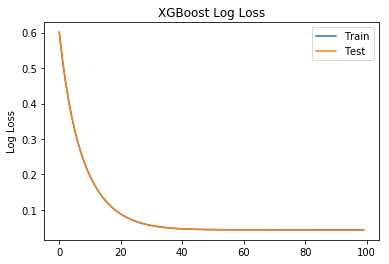

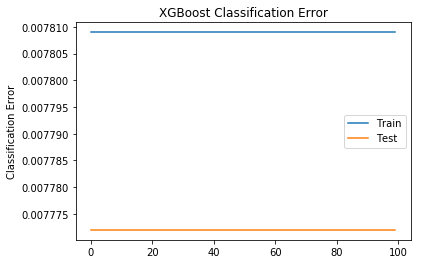

In [167]:
# retrieve performance metrics
results = model.evals_result()
epochs = len(results['validation_0']['error'])
x_axis = range(0, epochs)
# plot log loss
fig, ax = pyplot.subplots()
ax.plot(x_axis, results['validation_0']['logloss'], label='Train')
ax.plot(x_axis, results['validation_1']['logloss'], label='Test')
ax.legend()
pyplot.ylabel('Log Loss')
pyplot.title('XGBoost Log Loss')
pyplot.show()
# plot classification error
fig, ax = pyplot.subplots()
ax.plot(x_axis, results['validation_0']['error'], label='Train')
ax.plot(x_axis, results['validation_1']['error'], label='Test')
ax.legend()
pyplot.ylabel('Classification Error')
pyplot.title('XGBoost Classification Error')
pyplot.show()

In [144]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)
from sklearn.svm import LinearSVC
clf = LinearSVC(random_state=0, tol=1e-5)
clf.fit(X_train, y_train)
predictions = clf.predict(X_test)
print('Score:', clf.score(X_test, y_test))
scores = cross_val_score(model, X, y, cv=6)
print('Cross-validated scores:', scores)
y_pred = model.predict(X_test)
predictions = [round(value) for value in y_pred]
accuracy = accuracy_score(y_test, predictions)
print("Accuracy: %.2f%%" % (accuracy * 100.0))

Score: 0.9915304547433411
Cross-validated scores: [0.99216413 0.99221125 0.99221088 0.99221088 0.99221088 0.99221088]
Accuracy: 99.15%


#### Random Forest Classifer

In [145]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)
X_train, y_train = make_classification(n_samples=5000, n_features=24,
                           n_informative=2, n_redundant=0,
                           random_state=0, shuffle=False)
clf = RandomForestClassifier(n_estimators=100, max_depth=2,
                             random_state=0)
clf.fit(X_train, y_train)
predictions = clf.predict(X_test)
print('Score:', clf.score(X_test, y_test))
scores = cross_val_score(clf, X, y, cv=6)
print('Cross-validated scores:', scores)
y_pred = clf.predict(X_test)
predictions = [round(value) for value in y_pred]
accuracy = accuracy_score(y_test, predictions)
print("Accuracy: %.2f%%" % (accuracy * 100.0))

Score: 0.9690901175446234
Cross-validated scores: [0.99216413 0.99221125 0.99221088 0.99221088 0.99221088 0.99221088]
Accuracy: 96.91%
